<img src='./images/LogoWekeo_Copernicus_RGB_0.png' alt='Logo EU Copernicus EUMETSAT' align='right' width='20%'></img>

**Author:** Luigi Selmi <br>
**Copyright:** 2022 Luigi Selmi <br>
**License:** MIT

<div class="alert alert-block alert-success">
<h3>Nitrogen Dioxide Forecast over Italy using the Copernicus Atmosphere Monitoring Service</h3></div>

# INTRODUCTION
The nitrogen dioxide ($NO_2$) is a highly reactive gas that plays an important role in the chemistry of the atmosphere. In the troposphere its concentration is due to combustion processes. It plays a role in the concentration of ozone ($O_3$) and a meausure of the $NO_2$ concentration is a proxy of the $O_3$ concentration as well. A long exposition to high concentrations of $NO_2$ and $O_3$ may result in adverse health impacts. For these reasons the concentration of $NO_2$ in the troposhere, and even more at the ground level, is an important indicator of air quality. More information about the origin of NO2 and its relevance on the air quality is available at the [EUMETSAT website](https://training.eumetsat.int/mod/page/view.php?id=13823) and from the [Julien Chimot's](https://wordpress71133.wordpress.com/no2-nitrogen-dioxide/) blog. 

### Data used

| Product Description | Product Navigator | WEkEO HDA ID | WEkEO metadata |
|:--------------------:|:-------------:|:-----------------:|:-----------------:|
| CAMS European Air Quality Forecasts | <a href="https://ads.atmosphere.copernicus.eu/cdsapp#!/dataset/cams-europe-air-quality-forecasts?tab=overview" target="_blank">link</a> | EO:ECMWF:DAT:CAMS_EUROPE_AIR_QUALITY_FORECASTS | <a href="https://www.wekeo.eu/data?view=dataset&dataset=EO%3AECMWF%3ADAT%3ACAMS_EUROPE_AIR_QUALITY_FORECASTS" target="_blank">link</a> |

### Learning outcomes

In this notebook you will learn;

* How the TROPOMI instrument on board Sentinel-5p measures the $NO_2$ concentration.
* How to get the $NO_2$ forecast over a time window of several days.
* How to visualise the forecast.
* How to interpret the data.


### Outline
The CAMS service provides the [Air Quality Forecasts for Europe](https://ads.atmosphere.copernicus.eu/cdsapp#!/dataset/cams-europe-air-quality-forecasts). The dataset provides the forecasts for many polluttants such as $NO_x$, $O_3$, particulate matter (PM2.5 and PM10) and $SO_2$ with a spatial resolution of 10 km. In this test we want to retrieve the forecasts for $NO_2$ over the Italian peninsula at ground level every hours for the next 96 hours (lead times) and visualize the forecasts as a sequence of frames in an animation. 

<div class="alert alert-info" role="alert">

## <a id='TOC_TOP'></a>Contents

</div>
    
 1. [The TROPOMI instrument](#The-Tropomi-Instrument)
 2. [The CAMS European air quality forecasts](#The-CAMS-European-air-quality-forecasts)
 3. [The Harmonised Data Access API](#The-Harmonised-Data-Access-API)
 4. [Nitrogen dioxide forecast visualization](#Nitrogen-dioxide-forecast-visualization)
 5. [Nitrogen dioxide forecast animation](#Nitrogen-dioxide-forecast-animation)
 6. [References](#References)

<hr>

## The TROPOMI Instrument
The TROPOspheric Monitoring Instrument (TROPOMI) is the only payload of Sentinel-5p and is dedicated to the monitoring of trace gases and particulate in the atmosphere and in particular in its lower layer, the troposphere. It is a passive remote sensing instrument and depends on the sun light reflected from the Earth surface through the atmosphere. The trace gases monitored are: ozone $(O_3)$, nitrogen dioxide $(NO_2)$, sulfur dioxide $(SO_2)$, carbon monoxide $(CO)$, methane $(CH_4)$, formaldehyde $(HCHO)$. 

|![The Copernicus Sentinel-5p](images/sentinel-5p.jpg)| 
|:--:|
|*The Copernicus Sentinel-5p with its payload, the TROPOMI instrument (Credit: ESA)*|

The instrument is composed of 4 spectrometers that collect the light coming from nadir in 4 spectral bands: UV (267-332 nm), UV-VIS (305-499 nm), NIR (661-786 nm), and SWIR (2300-2389 nm). The light arriving at the instrument is filtered, sent to the detector of each spectrometer, transformed into a voltage signal, amplified and finally digitized in order to be transferred to the ground station. The detector of the UV-VIS-NIR bands is a CCD. The detector of the SWIR band is CMOS device (see [3]). The total and tropospheric column of the trace gases is extracted from the detector signal using the Differential optical absorption spectroscopy (DOAS). The technique is based on the Beer-Lambert law for which the intensity of the light at a particular wavelenght received at the detector, depends on the amount of light that is absorbed in the path between the source and the detector, and on the density of the absorbing molecules. The Beer-Lambert law has the form

$$I(\lambda) = I_0(\lambda)exp(-\sum_{j=1}^n \sigma_j(\lambda)\rho_j)$$

where $\lambda$ is the wavelenght of the detected light, $\sigma_j(\lambda)$ is the absorption cross section of the species j, and $\rho_j$ is its column density. Assuming $\sigma_j(\lambda)$ are known from laboratory measurements, taking n measures of $I(\lambda)$ we have a system of n equations in n unknown variables $\rho_j$ that can be solved (see [6]). After this very short and simplified description of the instrument and the inversion algorithm, we can proceed using the data.


In [1]:
import xarray as xr
import pandas as pd
import numpy as np
#import cdsapi
from hda import Client
import warnings
warnings.filterwarnings('ignore')
from platform import python_version
print("python version: %s"%python_version())
print("pandas version: %s"%pd.__version__)
print("xarray version: %s"%xr.__version__)

python version: 3.9.13
pandas version: 1.4.3
xarray version: 2022.3.0


## The CAMS European air quality forecasts
The Copernicus Atmosphere Monitoring Service ([CAMS](https://atmosphere.copernicus.eu/)) provides analysis and forecasts related to air quality, atmospheric composition, greenhouse gases, solar irradiance. The datasets released by the CAMS service is the result of assimilation processes in which observations from satellites and ground stations are used to update a numerical model. The CAMS is operated by the European Centre for Medium-Range Weather Forecasts ([ECMWF](https://www.ecmwf.int/)) on behalf of the European Commission. The forecasts for the air quality are the result of computer simulations, performed by the ECMWF, using a technique called data assimilation. The technique uses new observations, in our case from the [TROPOMI](http://www.tropomi.eu/) instrument onboard the [Copernicus Sentinel-5p](https://sentinel.esa.int/web/sentinel/missions/sentinel-5p), to update the initial conditions of a numerical model of the atmosphere that will be used for the next simulation that will represent the most up to date forecast. 

## The Harmonised Data Access API
The CAMS provides its datasets as open data, available to all for free, through a web page and a web service. For the air quality forecasts a user can select, among other options

- the variables, that is the physical parameters we are interested in 
- the model we want to use, nine models are available plus the ensemble 
- the levels, or heights for which we want the forecasts
- the area of interest, delimited by north and south latitudes and west and east longitudes 
- the date from which the forecast should start
- the lead time hours, that is the hours of the forecasts
- the format of the data (CSV, NetCDF)

In this notebook we use the web service through its API. In order to use the API you need an API key that will be given to you after you have registered into the CADS. The steps to use the CAMS web service are

1. login 
2. copy your ADS API key in the .condarc file in your home folder 
3. install the cdsapi Python package

You can also pass your API key and the web service url to the client API instead of copying them into your .condarc file. For more information follow the [how-to instructions](https://ads.atmosphere.copernicus.eu/api-how-to). 

We set some parameters before submitting our request, in particular the area of interest, the variable (NO2), the lead time hours.

In [2]:
path = 'data/air_quality_forecasts'
start_date = '2022-07-23'
end_date = '2022-07-26'
filename = 'air_quality_forecast_' + start_date + '.nc'
time = "00:00" # time must be 00:00 otherwise the request fails.
bb_north = 47.50379785942417
bb_south = 34.82621887953009
bb_west = 5.899000073477433
bb_east = 20.721255946087158

In [3]:
data = {
  "datasetId": "EO:ECMWF:DAT:CAMS_EUROPE_AIR_QUALITY_FORECASTS",
  "boundingBoxValues": [
    {
      "name": "area",
      "bbox": [
        bb_west,
        bb_north,
        bb_east,
        bb_south
      ]
    }
  ],
  "dateRangeSelectValues": [
    {
      "name": "date",
      "start": start_date,
      "end": end_date
    }
  ],
  "multiStringSelectValues": [
    {
      "name": "variable",
      "value": [
        "nitrogen_dioxide"
      ]
    },
    {
      "name": "level",
      "value": [
        "0"
      ]
    },
    {
      "name": "time",
      "value": [
        "00:00"
      ]
    },
    {
      "name": "leadtime_hour",
      "value": [
            "0", "1", "10",
            "11", "12", "13",
            "14", "15", "16",
            "17", "18", "19",
            "2", "20", "21",
            "22", "23", "24",
            "25", "26", "27",
            "28", "29", "3",
            "30", "31", "32",
            "33", "34", "35",
            "36", "37", "38",
            "39", "4", "40",
            "41", "42", "43",
            "44", "45", "46",
            "47", "48", "49",
            "5", "50", "51",
            "52", "53", "54",
            "55", "56", "57",
            "58", "59", "6",
            "60", "61", "62",
            "63", "64", "65",
            "66", "67", "68",
            "69", "7", "70",
            "71", "72", "73",
            "74", "75", "76",
            "77", "78", "79",
            "8", "80", "81",
            "82", "83", "84",
            "85", "86", "87",
            "88", "89", "9",
            "90", "91", "92",
            "93", "94", "95",
            "96"
        ]
    },
    {
      "name": "model",
      "value": [
        "ensemble"
      ]
    },
    {
      "name": "type",
      "value": [
        "forecast"
      ]
    }
  ],
  "stringChoiceValues": [
    {
      "name": "format",
      "value": "netcdf"
    }
  ]
}

In [7]:
c = Client(url='https://wekeo-broker.apps.mercator.dpi.wekeo.eu/databroker', user='xxxxxx', password='xxxxxxxxxx')
matches = c.search(data)
matches.download()

2022-07-24 17:34:53,475 INFO Downloading https://wekeo-broker.apps.mercator.dpi.wekeo.eu/databroker/dataorder/download/AKRxGcXSt9NuRhVLaBnM_dLX_YA to adaptor.cams_regional_fc.retrieve-1658676843.3715577-8250-5-85cc1232-0572-4276-8d43-0978423f776f.zip (13.9M)
2022-07-24 17:36:25,375 INFO Download rate 155.1K/s 


In [26]:
for match in matches.results:
    fdst = match['filename']
    print(f"Found: {fdst}")

Found: adaptor.cams_regional_fc.retrieve-1658577232.1449525-22168-11-662a955e-f3c0-41ee-b6d4-5a2144280fbe.nc


In [27]:
import os
os.rename(fdst, path + '/' + filename)

## Nitrogen dioxide forecast visualization
The data product that we have selected is based on an ensemble of the outputs of nine Earth System models. Let's open the file to get the forecasts for $NO_2$

In [19]:
def getforecast(path, filename):
    # The forecasts for NO2 are in the 'no2_conc' variable. 
    # The function puts the data in memory, closes the file
    # and returns the NO2 forecast
    with xr.open_dataset(path + '/' + filename) as ds:
        no2_forecast = ds['no2_conc']
        return no2_forecast

In [20]:
no2_forecasts = getforecast(path, filename)
no2_forecasts

<xarray.DataArray 'no2_conc' (time: 97, level: 1, latitude: 127, longitude: 148)>
[1823212 values with dtype=float32]
Coordinates:
  * longitude  (longitude) float32 5.95 6.05 6.15 6.25 ... 20.45 20.55 20.65
  * latitude   (latitude) float32 47.45 47.35 47.25 47.15 ... 35.05 34.95 34.85
  * level      (level) float32 0.0
  * time       (time) timedelta64[ns] 00:00:00 01:00:00 ... 4 days 00:00:00
Attributes:
    species:        Nitrogen Dioxide
    units:          µg/m3
    value:          hourly values
    standard_name:  mass_concentration_of_nitrogen_dioxide_in_air

As we can see from the description, the time interval of each forecast is provided as a delta in nanoseconds (ns), from the first lead time to the next. Since we have requested a forecast every hour the delta is 3600 * 10^9, or 3600000000000, nanoseconds. We will create a date time index to be used later on in the plots 

In [7]:
delta_time = 3600000000000 # delta between one lead time and the next one
num_forecasts = len(no2_forecasts)
start_day = pd.to_datetime(start_date)
date_index = start_day + pd.to_timedelta(np.arange(num_forecasts), 'H')
date_index.size
start_day.strftime('%Y-%m-%d %H:%M:%S')

'2022-07-23 00:00:00'

We plot the forecast for one lead time hour to check that everything works fine and then we'll create an animation using all the forecasts. 

In [8]:
import matplotlib
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy
print("matplotlib version: %s"%matplotlib.__version__)
print("cartopy version: %s"%cartopy.__version__)

matplotlib version: 3.5.2
cartopy version: 0.20.3


We create the figure that we will use to plot the data

In [11]:
def create_figure(): 
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.add_feature(cartopy.feature.OCEAN)
    ax.add_feature(cartopy.feature.LAND, edgecolor='black')
    ax.coastlines()
    ax.set_extent([bb_west, bb_east, bb_south, bb_north], ccrs.PlateCarree())
    gl = ax.gridlines(draw_labels=True, linestyle='--')
    return fig, ax

Let's plot the first forecast. 

Text(0.5, 1.0, 'Air Quality Forecast - 2022-07-23 00:00:00')

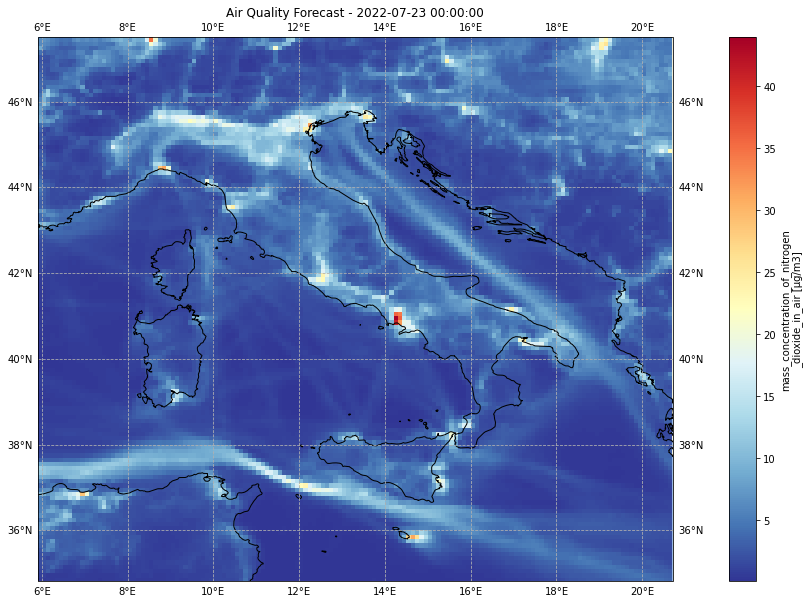

In [12]:
_, ax = create_figure()
lead_time = 1
first_forecast = no2_forecasts.sel(time = str(delta_time * lead_time), level = 0.0)
first_forecast.plot.pcolormesh(ax=ax, x='longitude', y='latitude', add_colorbar=True, cmap='RdYlBu_r')
plt.title('Air Quality Forecast - {0:s}'.format(date_index[lead_time - 1].strftime('%Y-%m-%d %H:%M:%S')))
#plt.savefig('images/forecast_example.png')

We can notice the NO2 traces in the Mediterranean sea, in particular in the Strait of Sicily and over the major Italian ports. The traces are due to combustion of fossil fuels of the ships. 

## Nitrogen dioxide forecast animation
Now we create the animation using all the forecasts at ground level. The animation will contain a frame for each forecast (or lead time)

In [13]:
import matplotlib.animation as animation
from IPython.display import HTML, display

forecasts = no2_forecasts.sel(level = 0.0)

def draw(frame, add_colorbar):    
    forecast_frame = forecasts.sel(time = str(delta_time * frame))
    plot = forecast_frame.plot.pcolormesh(ax=ax, x='longitude', y='latitude', add_colorbar=add_colorbar, cmap='RdYlBu_r')
    title = 'Air Quality Forecast - {0:s}'.format(date_index[frame - 1].strftime('%Y-%m-%d %H:%M:%S'))
    ax.set_title(title)
    return plot

def init():
    return draw(1, add_colorbar=True)

def animate(frame):
    plt.close()
    return draw(frame + 1, add_colorbar=False)

In [14]:
fig, ax = create_figure()


ani = animation.FuncAnimation(fig, animate, frames=96, interval=500, blit=False, init_func=init, repeat=False)

HTML(ani.to_jshtml())

## References
1. [ECMWF Copernicus Knowledge Base - Global atmospheric composition forecast data documentation](https://confluence.ecmwf.int/display/CKB/CAMS%3A+Global+atmospheric+composition+forecast+data+documentation)
2. [WMO Observing Systems Capability Analysis and Review Tools - TROPOMI Instrument details](https://space.oscar.wmo.int/instruments/view/tropomi)
3. [ESA Sentinel-5p TROPOMI - Algorithm theoretical basis document (ATBD) for the TROPOMI L01b data processor](https://sentinels.copernicus.eu/web/sentinel/technical-guides/sentinel-5p/products-algorithms)
4. [ESA Sentinel-5p TROPOMI - ATBD of the total and tropospheric NO2 data products](https://sentinels.copernicus.eu/web/sentinel/technical-guides/sentinel-5p/products-algorithms)
5. [Wikipedia - Differential optical absorption spectroscopy](https://en.wikipedia.org/wiki/Differential_optical_absorption_spectroscopy)
6. [ESA - Atmospheric Toolbox - QDOAS Software user manual](https://atmospherictoolbox.org/qdoas/)